##  Setup

With this Google Colaboratory (Colab) notebook open, click the "Copy to Drive" button that appears in the menu bar. The notebook will then be attached to your own user account, so you can edit it in any way you like -- you can even take notes directly in the notebook.

<h1 align="center">Python Open Labs: Exploratory analysis and visualization with pandas</h1>

## Welcome!

### Instructors
- Walt Gurley
- Claire Cahoon
- Scott Bailey
- Natalia Lopez
- Ashley Evans Bandy

### Open Labs agenda

1.   **Guided activity**: One of the instructors will share their screen to work through the guided activity and teach concepts along the way.

2.   **Open lab time**: After the guided portion of the Open Lab, the rest of the time is for you to ask questions, work collaboratively, or have self-guided practice time. You will have access to instructors and peers for questions and support.

Breakout rooms will be available if you would like to work in small groups. If you have trouble joining a room, ask in the chat to be moved into a room.

### Learning objectives

By the end of our workshop today, we hope you'll understand how to aggregate, group, and visualize data in pandas.

### Today's Topics
- Aggregation methods (average, minimum, maximum)
- Grouping a dataframe with `groupby`
- Creating a bar chart
- Creating a line chart
- Using other data visualization libraries


### Using Zoom

Please make sure that your mic is muted during the workshop.

We will have live captioning enabled, you can switch this on and off from your toolbar at the bottom of the screen.

### Asking questions

Please feel free to ask questions in the Zoom chat throughout the demonstration.

Other instructors will be monitoring chat on Zoom. They will answer as able, and will collect questions with answers that might help everyone to answer at the end of the demonstration.

The open lab time is when you will be able to ask more questions and work together on the exercises.

### Using Jupyter Notebooks and Google Colaboratory

Jupyter notebooks are a way to write and run Python code in an interactive way. They're quickly becoming a standard way of putting together data, code, and written explanations or visualizations into a single document and sharing that. There are a lot of ways that you can run Jupyter notebooks, including just locally on your computer, but we've decided to use Google's Colaboratory notebook platform for this workshop.  Colaboratory is “a Google research project created to help disseminate machine learning education and research.”  If you would like to know more about Colaboratory in general, you can visit the [Welcome Notebook](https://colab.research.google.com/notebooks/welcome.ipynb).

Using the Google Colaboratory platform allows us to focus on learning and writing Python in the workshop rather than on setting up Python, which can sometimes take a bit of extra work depending on platforms, operating systems, and other installed applications. If you'd like to install a Python distribution locally, though, we're happy to help. Feel free to [get help from our graduate consultants](https://www.lib.ncsu.edu/dxl) or [schedule an appointment with Libraries staff](https://go.ncsu.edu/dvs-request).



---


## Guided Instruction
This week we're focusing on exploratory analysis of our dataset. We'll go through the process of asking a question, using pandas to find the data to help answer it, and then visualizing that data.

Content Warning: This dataset contains information relating to violence towards animals. We understand that this may be distressing, and if you need to step away from the workshop we understand.

In this section, we will work through examples using data from the [Federal Aviation Administration (FAA) Wildlife Strikes Database](https://wildlife.faa.gov/search). We have filtered the data to only include North Carolina.

> "The FAA Wildlife Strike Database contains records of reported wildlife strikes since 1990. Strike reporting is voluntary. Therefore, this database only represents the information we have received from airlines, airports, pilots, and other sources." - [FAA website](https://wildlife.faa.gov/home)

### Import the dataset

In [ ]:
# Import the pandas library as pd (callable in our code as pd)
import pandas as pd

In [ ]:
# Import the data from a csv file (wildlife strike data from the years 1990-2020)
# This dataset was cleaned based on methods from previous workshops
csv_file_url = 'https://raw.githubusercontent.com/NCSU-Libraries/data-viz-workshops/master/Python_Open_Labs/data/FAA_Wildlife_strikes_clean.csv'
wl_strikes = pd.read_csv(csv_file_url)

# Print out the first five columns of the dataset
wl_strikes.head()

,INDX_NR,INCIDENT_DATE,INCIDENT_MONTH,INCIDENT_YEAR,TIME,TIME_OF_DAY,AIRPORT_ID,AIRPORT,RUNWAY,LOCATION,ENROUTE STATE,OPID,OPERATOR,REG,FLT,AIRCRAFT,AMA,AMO,EMA,EMO,AC_CLASS,AC_MASS,TYPE_ENG,NUM_ENGS,PHASE_OF_FLIGHT,HEIGHT,SPEED,DISTANCE,SKY,PRECIPITATION,AOS,COST_REPAIRS,OTHER_COST,COST_REPAIRS_INFL_ADJ,COST_OTHER_INFL_ADJ,INGESTED,INDICATED_DAMAGE,DAMAGE_LEVEL,OTHER_SPECIFY,EFFECT,EFFECT_OTHER,SPECIES_ID,SPECIES,REMARKS,REMAINS_COLLECTED,REMAINS_SENT,WARNED,BIRDS_SEEN,BIRDS_STRUCK,SIZE,NR_INJURIES,NR_FATALITIES,COMMENT,SOURCE,PERSON,SINGLE_OR_MULTI_ENGINE,HOUR,MONTH_NAME,SPECIES_GENERALIZE,SPECIES_TYPE
0,1080125,2020-11-05,11,2020,05:00,NaN,KRDU,RALEIGH-DURHAM INTL,23R,NaN,NaN,UPS,UPS AIRLINES,N253UP,1276,MD-11,583,39.0,22.0,7.0,A,4.0,D,3.0,Approach,NaN,NaN,NaN,No Cloud,None,NaN,NaN,NaN,NaN,NaN,False,False,N,NaN,None,NaN,ZX004,Dark-eyed junco,"Fuselage, above FO clearview sliding window.",True,True,Unknown,,1,Small,NaN,NaN,NaN,FAA Form 5200-7-E,Airport Operations,Multi-engine,5.0,November,Dark-eyed junco,Flying animal
1,1080118,2020-11-05,11,2020,22:35,NaN,KGSO,PIEDMONT TRIAD INTL,5R,NaN,NaN,FDX,FEDEX EXPRESS,N950FD,1624,B-757-200,148,26.0,37.0,37.0,A,4.0,D,2.0,Take-off Run,0.0,NaN,0.0,Some Cloud,None,NaN,NaN,NaN,NaN,NaN,False,False,NaN,part not reported,None,NaN,1F132,Common gray fox,Aircraft landed RWY 5R and reported a dead fox...,True,False,Unknown,1,1,Large,NaN,NaN,NaN,FAA Form 5200-7-E,Airport Operations,Multi-engine,22.0,November,Common gray fox,Land animal
2,1080126,2020-11-05,11,2020,11:00,Day,KCLT,CHARLOTTE/DOUGLAS INTL ARPT,36C,NaN,NaN,AAL,AMERICAN AIRLINES,N809NN,1433,B-737-800,148,43.0,10.0,1.0,A,4.0,D,2.0,Approach,NaN,NaN,NaN,No Cloud,None,NaN,NaN,NaN,NaN,NaN,False,False,N,NaN,None,NaN,UNKB,Unknown bird,Aircraft reportedly struck a bird during appro...,True,False,Yes,,1,NaN,NaN,NaN,NaN,FAA Form 5200-7-E,Airport Operations,Multi-engine,11.0,November,Unknown flying animal,Flying animal
3,1080130,2020-11-05,11,2020,06:52,Day,KCLT,CHARLOTTE/DOUGLAS INTL ARPT,36C,NaN,NaN,RPA,REPUBLIC AIRLINES,N643RW,3512,EMB-170,332,NaN,22.0,4.0,A,4.0,D,2.0,Climb,NaN,NaN,NaN,No Cloud,None,NaN,NaN,NaN,NaN,NaN,False,False,NaN,PART NOT REPORTED,None,NaN,UNKB,Unknown bird,Flight crew reported to CLT ATC that the aircr...,False,False,Yes,,1,NaN,NaN,NaN,NaN,FAA Form 5200-7-E,Airport Operations,Multi-engine,6.0,November,Unknown flying animal,Flying animal
4,1078243,2020-11-04,11,2020,05:20,Dawn,KRDU,RALEIGH-DURHAM INTL,23R,NaN,NaN,UPS,UPS AIRLINES,N259UP,1276,MD-11,583,39.0,22.0,7.0,A,4.0,D,3.0,Approach,NaN,NaN,NaN,No Cloud,None,NaN,NaN,NaN,NaN,NaN,False,False,N,NaN,None,NaN,Z6007,American robin,Captain side - clearview window forward frame....,True,True,Unknown,,1,Small,NaN,NaN,NaN,FAA Form 5200-7-E,Airport Operations,Multi-engine,5.0,November,American robin,Flying animal


### Exploratory analysis of the dataset

After observing and cleaning our dataset, it is now easier to conduct analyses on our data. We will conduct some numerical and visual analyses that will help us explore questions such as:

- How many unique species have been identified in the data set?
- Which species are struck the most?
- How have number of strikes changed over time?
- Are there times of the year when most strikes occur?
- How frequently are land-based animals involved?

We can do this by calculating summaries of rows and columns, grouping data, and visualizing the results.

### Aggregation methods

There are several methods that can be used to calculate aggregated values from the dataset, such as the number of unique values, unique value counts, minimum, maximum, and average.

#### Unique


We can use the `unique()` method on the "SPECIES" column to create an array of unique species names. 

The length of this array will provide the number of unique species.

In [ ]:
# Create a list of the unique species with unique()
unique_species = wl_strikes['SPECIES'].unique()

# Print out the unique species
unique_species

array(['Dark-eyed junco', 'Common gray fox', 'Unknown bird',
       'American robin', 'Killdeer', 'Eastern meadowlark',
       'Unknown bird - small', 'Unknown bird - medium',
       'Western meadowlark', 'Red-tailed hawk', 'Cuckoos',
       'Chimney swift', 'Gray-cheeked thrush', 'Black-and-white warbler',
       'Swamp sparrow', 'Microbats', 'Northern cardinal',
       'Common nighthawk', 'American kestrel', 'Hawks',
       'Bay-breasted warbler', 'Swallows', 'Yellow-billed cuckoo',
       'Merlin', "Swainson's thrush", 'Unknown bird - large',
       'Mourning dove', 'Barn swallow', 'Bald eagle', 'American redstart',
       'Red-eyed vireo', 'Doves', 'Eastern bluebird', 'Cliff swallow',
       'Evening bat', 'American goldfinch', 'Sparrows',
       'Grasshopper sparrow', 'European starling', 'Rock pigeon',
       'House finch', 'Brown-headed cowbird', 'Mallard',
       'Sandpipers, curlews, phalaropes, allies', 'Semipalmated plover',
       'Rose-breasted grosbeak', 'Cerulean warbler

In [ ]:
# Get the length of the new array using len()
# How many unique species are there?
len(unique_species)

209

#### Value counts

Value counts show how many instances there are of each unique entry in a column. Here, we are interested in seeing how many incidents there are in each month. This could tell us which months have the most accidents.

We will specify the `INCIDENT MONTH` column in our dataset and call the method `value_counts()`. This will return a Series with an index label of each unique month number and a value corresponding to the count of that month number in the `INCIDENT MONTH` column.

In [ ]:
# Count the occurance of unique values on the column 'INCIDENT_MONTH'
month_unique = wl_strikes['INCIDENT_MONTH'].value_counts()

# Sort the Series by its index using sort_index(), to help view yearly trend
month_unique.sort_index()

1     122
2     133
3     205
4     348
5     429
6     336
7     571
8     727
9     706
10    802
11    407
12    178
Name: INCIDENT_MONTH, dtype: int64

#### Minimum, maximum, average...

We can also calculate aggregates like the minimum, maximum, and mean of values in a DataFrame or Series. Here are a few examples:

- `mean()` to find the average of a range
- `min()` to find the smallest value
- `max()` to find the largest value
- `sum()` to sum the values of a range

In [ ]:
# Calculate the minimum values for each column
# Note the minimum values for columns not containing numbers (e.g., the minimum
# for strings is alphabetical order, with uppercase characters preceeding
# lowercase characters - "B" comes before "a")
wl_strikes.min()

INDX_NR                               608234
INCIDENT_DATE                     1985-01-06
INCIDENT_MONTH                             1
INCIDENT_YEAR                           1985
TIME                                        
AIRPORT_ID                              0NC4
AIRPORT                       ALBERT J ELLIS
RUNWAY                                      
ENROUTE STATE                            NaN
OPID                                    1ASQ
OPERATOR                         1US AIRWAYS
REG                                         
FLT                                         
AIRCRAFT                               A-300
AMO                                        0
EMA                                        1
EMO                                        1
AC_MASS                                    1
NUM_ENGS                                   1
HEIGHT                                     0
SPEED                                      2
DISTANCE                                   0
AOS       

In [ ]:
# Calculate the average height at which all strikes occurred
wl_strikes['HEIGHT'].mean()

1004.0237032905744

We can use the `agg()` method to call multiple aggregate functions at once.

In [ ]:
# Calculate the minimum, maximum, and average hour in which all strikes occurred
wl_strikes['HOUR'].agg(['mean', 'min', 'max'])

mean    14.182741
min      0.000000
max     23.000000
Name: HOUR, dtype: float64

### Group values using groupby

We may be interested in seeing our data in groups. For example, what does the data look like if we group by month and find the average of each column? Which month has the highest cost for repairs?

We can do this by calling `groupby()` on our dataset and passing in the column we would like to group by. We will group our data by the column `INCIDENT_MONTH`, find the mean of each column in the grouped data, and sort by the `COST_REPAIRS_INFL_ADJ` column to see which month has the highest average cost.

In [ ]:
# Group the dataset by "INCIDENT_MONTH"
data_by_month = wl_strikes.groupby('INCIDENT_MONTH')

# This creates a groupby object that contains information about the groups
type(data_by_month)

# Find the mean of the grouped data, then sort by "COST_REPAIRS_INFL_ADJ"
data_by_month.mean().sort_values('COST_REPAIRS_INFL_ADJ')

,INDX_NR,INCIDENT_YEAR,ENROUTE STATE,AMO,EMA,EMO,AC_MASS,NUM_ENGS,HEIGHT,SPEED,DISTANCE,AOS,COST_REPAIRS,OTHER_COST,COST_REPAIRS_INFL_ADJ,COST_OTHER_INFL_ADJ,INGESTED,INDICATED_DAMAGE,REMAINS_COLLECTED,REMAINS_SENT,NR_INJURIES,NR_FATALITIES,HOUR
INCIDENT_MONTH,,,,,,,,,,,,,,,,,,,,,,,
1,717243.163934,2007.237705,NaN,22.474227,20.463918,8.095745,3.303922,1.970874,183.936842,128.492308,0.121429,7.250000,2983.333333,90.000000,3273.666667,107.000000,0.057377,0.106557,0.327869,0.196721,NaN,NaN,14.594203
5,753083.261072,2011.279720,NaN,16.436111,20.718101,7.139881,3.633952,2.021220,1105.252336,149.320000,1.164319,8.772727,4500.000000,805.000000,6854.750000,1157.000000,0.034965,0.041958,0.403263,0.263403,1.0,NaN,14.125424
6,762391.678571,2011.029762,NaN,18.366935,19.547009,6.393013,3.607547,2.022642,395.413043,134.081081,0.344156,27.125000,8000.000000,381.666667,11104.000000,448.000000,0.041667,0.062500,0.482143,0.312500,NaN,NaN,12.986486
3,748455.268293,2010.000000,NaN,16.893750,20.067114,7.575342,3.488235,1.994083,815.860140,142.960396,1.130435,368.800000,49700.000000,244.000000,65161.200000,265.600000,0.053659,0.102439,0.370732,0.248780,1.0,NaN,14.475410
12,748477.696629,2010.134831,NaN,17.601399,20.000000,7.719697,3.500000,2.006667,370.761905,131.687500,0.082447,98.350000,50232.400000,1862.500000,72470.000000,2845.000000,0.044944,0.089888,0.426966,0.269663,NaN,NaN,12.324786
11,765890.503686,2010.393120,NaN,16.675926,19.720635,6.916667,3.647564,2.037249,1271.681507,147.566845,1.677041,191.750000,58628.571429,56286.250000,78689.833333,69386.250000,0.051597,0.066339,0.434889,0.312039,1.0,NaN,14.169675
8,764250.262724,2010.297111,NaN,18.292469,20.602996,6.802682,3.639399,2.046823,672.898635,140.093220,0.626609,56.684211,67188.500000,2305.166667,90533.500000,2955.500000,0.037139,0.055021,0.382393,0.232462,1.0,NaN,13.605664
7,758570.441331,2011.024518,NaN,17.317241,19.844444,6.970000,3.556291,2.015487,269.288221,131.206522,0.219789,103.941379,61885.000000,2310.416667,94538.750000,3500.545455,0.035026,0.045534,0.397548,0.231173,NaN,NaN,13.461126
4,763420.396552,2011.902299,NaN,17.759857,20.592742,6.245902,3.522034,2.016949,864.105485,147.414634,0.810471,58.000000,137600.000000,793.750000,144977.428571,908.250000,0.037356,0.077586,0.416667,0.272989,NaN,NaN,13.991736


You can also use `groupby()` to group data by multiple variables. We will create a hierarchical grouping of `INCIDENT_MONTH` and then `PRECIPITATION` to see the counts of different types of precipitation in each month using the `size()` groupby method.

In [ ]:
# Preview the unique values in the "PRECIPITATION" column
wl_strikes['PRECIPITATION'].unique()

# Group the data by month and then precipitation and get the count of each type
# of precipitation during each month using size()
wl_strikes.groupby(['INCIDENT_MONTH', 'PRECIPITATION']).size()

INCIDENT_MONTH  PRECIPITATION
1                Fog              11
                 None             63
                 Rain              9
2                Fog               3
                 Fog, Rain         1
                 None             81
                 Rain             10
3                Fog               7
                 None            121
                 Rain             18
                 Snow              1
4                Fog               1
                 None            217
                 Rain             28
5                Fog               6
                 None            293
                 Rain             23
6                Fog               2
                 None            198
                 Rain             19
                 Snow              1
7                Fog              10
                 None            355
                 Rain             18
                 Snow              1
8                Fog              10
        

### Data Visualization with matplotlib

We can use pandas coupled with the [matplotlib visualization library](https://matplotlib.org/index.html) to create basic charts, such as line graphs, bar charts, and scatter plots.

To do this, we first need to import the [matplotlib pyplot interface](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.html#module-matplotlib.pyplot), as `plt`, to access the plotting functionality of matplotlib.

For all of our charts we will use the matplotlib integration with pandas data structures by calling the method [`plot()`](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.plot.html#pandas.DataFrame.plot) on a DataFrame or Series.

In [ ]:
# Import the matplotlib pyplot interface as plt (callable in our code as plt)
from matplotlib import pyplot as plt

#### Create a Bar Chart

We want to find the top ten most struck species and show the number of incidents in which they were involved.

**Questions to consider with this data:**

- What is the most struck species?
- Approximately how many times has the tenth most struck species been involved in aircraft strikes?

We will aggregate the `SPECIES_GENERALIZE` using the `value_counts()` method. 

The `SPECIES_GENERALIZE` column is a generalized version of the `SPECIES` column in which the generalized name "Unknown flying animal" is substituted for various "Unknown" listings (e.g., "Unknown bird - large", "Unknown bat", etc.) in the `SPECIES` column. We need to remove all values with the label `Unknown flying animal` using the `drop()` method so we only include identifiable species in our analyses.

In [ ]:
# Get the number of strike records for each species type using "SPECIES_GENERALIZE"
unique_species_count = wl_strikes['SPECIES_GENERALIZE'].value_counts()

# Drop the row from the Series with the index label "Unknown flying animal"
unique_species_count = unique_species_count.drop(labels='Unknown flying animal')

# Print the first 10 values using head()
unique_species_count.head(10)

Mourning dove         234
Killdeer              151
European starling     140
Gulls                 136
Chimney swift         135
Rock pigeon            99
Sparrows               96
Barn swallow           85
Eastern meadowlark     77
American robin         65
Name: SPECIES_GENERALIZE, dtype: int64

Now that the data is formatted, we can create a [bar graph](https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.bar.html) to visualize the ten species that are most involved in strikes and the count of records of each.

We create a bar plot of the first ten values of the "unique species" Series by calling the `plot()` method on our Series with the keyword argument `kind='bar'`.

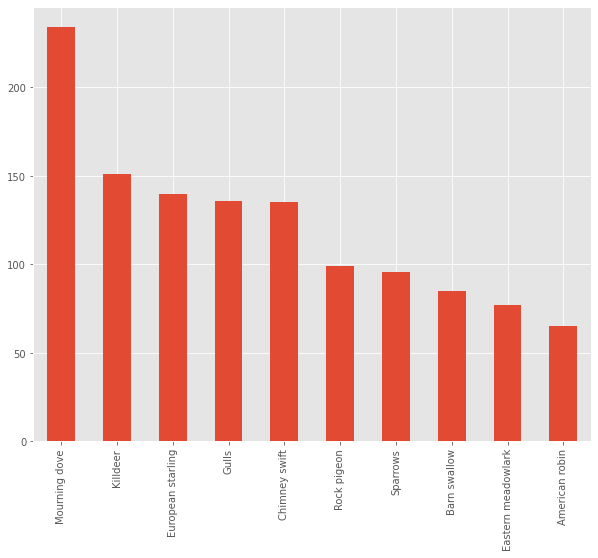

In [ ]:
# Select the first ten values from the unique species count list using iloc
first_ten = unique_species_count.iloc[:10]

# Create a bar chart ("bar") with the labels (species name) along the horizontal
# axis and value counts (number of records) along the vertical axis
first_ten.plot(kind='bar')

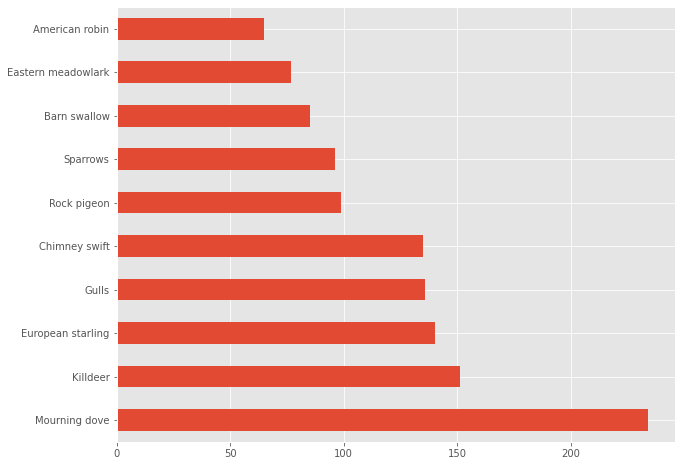

In [ ]:
# Now create a horizontal bar chart ("barh") with the labels (species name) along 
# the vertical axis and value counts (number of records) along the horizontal axis
first_ten.plot(kind='barh')

#### Setting global chart styles

We can set some basic graphic global paramenters for our plots–the overall [style of the plots and the size of the plots](https://matplotlib.org/3.3.3/tutorials/introductory/customizing.html) by editing `plt.rcParams` and setting `plt.style`. These settings will apply to all plots created after running the following cells.

You can view examples of various styles in the [Matplotlib Style Gallery](https://tonysyu.github.io/raw_content/matplotlib-style-gallery/gallery.html).

In [ ]:
# Set the default size of the plots to 10 inches wide and 8 inches tall
plt.rcParams['figure.figsize'] = [10, 8]

In [ ]:
# Set the default graphic style of the plots
# See more styles in the "Matplotlib Style Gallery", here we will change the
# style to 'ggplot'
plt.style.use('ggplot')

After setting thes global styles, re-run the horizontal bar chart above to see the formatting differences.

#### Create a Line Graph

We want to show the change in total strikes per year over the year range of our dataset.

**Questions to consider with this data:**

- What is the general trend in wildlife strikes over time? What could this trend be related to?
- Should there be any considerations for the year range of our dataset? Are there years that we can remove?

We will first calculate the `value_counts()` of the `INCIDENT_YEAR` column

In [ ]:
# Get the number of strikes that occurred in each year using value_counts()
strikes_per_year = wl_strikes['INCIDENT_YEAR'].value_counts()

# Print out the strikes per year series
strikes_per_year

2019    505
2017    376
2018    375
2016    338
2014    327
2015    324
2013    245
2011    238
2012    232
2020    212
2010    162
2009    130
2008    126
2000    108
2001    103
2006     96
1998     87
1994     84
2002     83
2004     81
2003     81
2005     79
1995     75
2007     74
1997     71
1999     70
1992     67
1991     58
1996     57
1990     52
1993     47
1985      1
Name: INCIDENT_YEAR, dtype: int64

We then sort the values based on the index, the year of occurrence, so that our data is sorted by year and not value counts.

In [ ]:
# Sort the new Series by the index values, the year
strikes_per_year = strikes_per_year.sort_index()

# Print out the sorted strikes per year series
strikes_per_year

1985      1
1990     52
1991     58
1992     67
1993     47
1994     84
1995     75
1996     57
1997     71
1998     87
1999     70
2000    108
2001    103
2002     83
2003     81
2004     81
2005     79
2006     96
2007     74
2008    126
2009    130
2010    162
2011    238
2012    232
2013    245
2014    327
2015    324
2016    338
2017    376
2018    375
2019    505
2020    212
Name: INCIDENT_YEAR, dtype: int64

We will use the matplotlib "line" plot type to create a [line chart](https://matplotlib.org/3.1.0/api/_as_gen/matplotlib.pyplot.plot.html) that shows the change in total strikes per year over the year range of our dataset.

To create the line plot we call the `plot()` method on the `strikes_per_year` Series and pass in the keyword arguments `kind='line`.


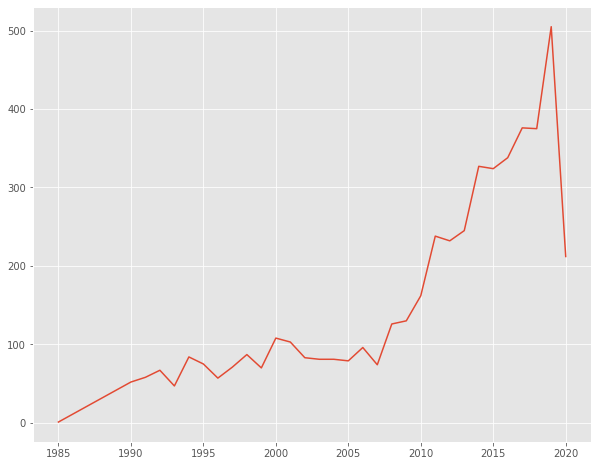

In [ ]:
# Plot the total strikes per year
strikes_per_year.plot(kind='line')

#### Set the style of the plot

We can manipulate the graphical encoding of our plot data in multiple ways. We can use the keyword argument `style` in our plot method to pass a shorthand styling string. For example, the style arguments `style='o-g'` are a shorthand to indicate that we want our data points (markers) to be represented by a green (g) circle (o) and conected by a solid line (-). You can find other shorthand style arguments for formatting markers and lines in the [matplotlib plot documentation](https://matplotlib.org/2.1.2/api/_as_gen/matplotlib.pyplot.plot.html).

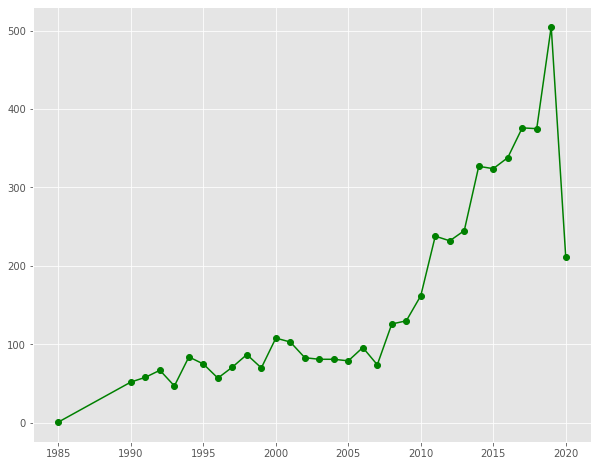

In [ ]:
# Plot the total strikes per year using a solid green line connecting data
# points and a solid green circle representing a data point
strikes_per_year.plot(kind='line', style='o-g')

You can also set specific data encoding styles using various keyword arguments in the `plot()` method. In this example we set the color of the line (`color='hotpink'`), the line width (`linewidth='3'`), the marker style (`marker='o'`), the marker fill (`markerfacecolor='white'`), marker stroke (`markeredgecolor='black'`), and marker size (`markersize=8`) explicitly

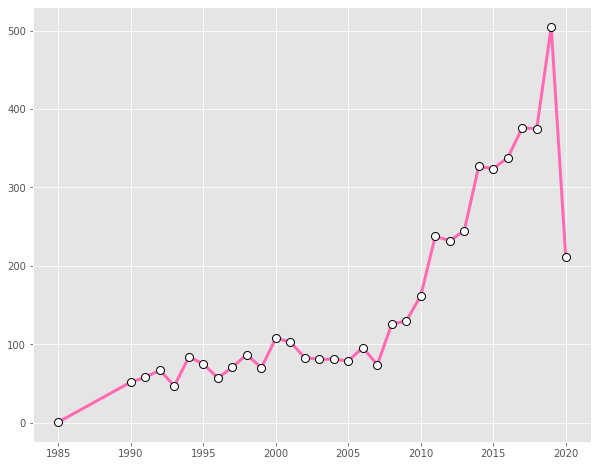

In [ ]:
strikes_per_year.plot(kind='line', color='hotpink', linewidth='3', marker='o',
                      markerfacecolor='white', markeredgecolor='black',
                      markersize=8)

To make our chart more descriptive and easy to interperet, we can set the plot title and axis labels. Here we will store our plot as a matplotlib `Axes` object in a variable by calling the `plot()` method. We can then call the methods `set_title()`, `set_xlabel()`, and `set_ylabel()` on this variable to set a descriptive title, x axis label, and y axis label, respectively.

Note that you can also set these labels in the `plot()` method using keyword arguments (e.g., `xlabel`, `ylabel`, `title`) similar to the previous way in which we set style parameters.

Text(0, 0.5, 'Total strikes')

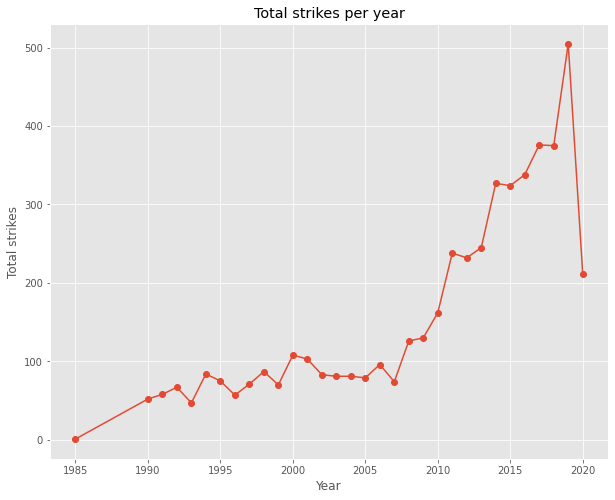

In [ ]:
# Create a variable that stores the plot
per_year_plot = strikes_per_year.plot(kind='line', style='o-')

#Change titles and axis labels with set_title(), set_xlabel(), and set_ylabel()
per_year_plot.set_title("Total strikes per year")
per_year_plot.set_xlabel("Year")
per_year_plot.set_ylabel("Total strikes")

#### Saving a plot

`matplotlib` provides functionality for saving a figure as an image using the method `savefig()`. We need to get the figure from our plot by calling `get_figure` on the matplotlib `Axes` object and the calling the method `savefig()`.

In [ ]:
# Save the strikes per year plot as a png
per_year_plot.get_figure().savefig('test.png')

# Save a high resolution version of the plot by setting a high dpi
per_year_plot.get_figure().savefig('test_hr.png', dpi=300)

# Save a vectorized version of the plot (svg)
per_year_plot.get_figure().savefig('test_hr.svg')

### Other Data Visualization Libraries

`matplotlib` is not the only option for creating data visualizations, there are other libraries that offer additional styling and interactive options.

#### Create a Histogram with Seaborn

Seaborn is a common visualization library that builds on matplotlib and provides more robust options. You can learn more and find documentation on the [seaborn website](https://seaborn.pydata.org/)

In [ ]:
# Import the Seaborn library as sns (callable in our code as sns)
import seaborn as sns

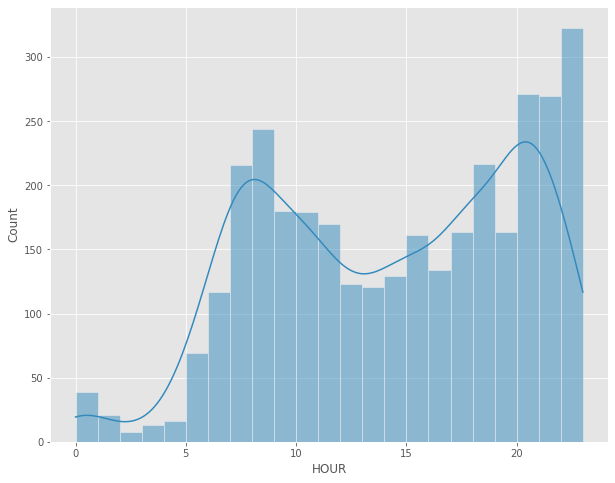

In [ ]:
# Create a histogram of the incident hour by calling histplot() in Seaborn
# Set the histogram bin width to one and include a kernel density estimate (kde)
# to show a smooth histogram
sns.histplot(wl_strikes['HOUR'], binwidth=1, kde=True)

#### Create an interactive line chart with Altair

Altair is an open-source, declariative visualization library. You can learn more and find documentation on the [Altair website](https://altair-viz.github.io/index.html).

In [ ]:
# Import the Altair library as alt (callable in our code as alt)
import altair as alt

In [ ]:
# Create an interactive Altair line chart of total incidents per year
# Include a tooltip to show the year and incident count when a user
# hovers over a data point
alt.Chart(wl_strikes).mark_line(point=True).encode(
    x='INCIDENT_YEAR',
    y='count(INCIDENT_YEAR)',
    tooltip = ['count(INCIDENT_YEAR)', 'INCIDENT_YEAR']
)

alt.Chart(...)



---


## Open work time
You can use this time to ask questions, collaborate, or work on the following activities (on your own or in a group)

### Exercise 1: Aggregation

Find the average, minimum, and maximum from the column 'SPEED'.

In [ ]:
# Get general statistics of altitude when strike occured
wl_strikes['SPEED'].agg(['mean', 'min', 'max'])

mean    147.945344
min       2.000000
max     300.000000
Name: SPEED, dtype: float64

### Exercise 2: Grouping Values

Find how expensive repairs (the data in column `'COST_REPAIRS_INFL_ADJ'`) were at each time of day (dawn, dusk, day, and night). Group the data using `TIME_OF_DAY`, then show a table with the average cost of repairs for each time of day, sorted from least expensive to most expensive.



> Bonus discussion question: does showing the data this way tell the whole story? What other factors could affect these numbers?



In [ ]:
# Create a variable that stores clean_data grouped by TIME_OF_DAY
data_by_month = wl_strikes.groupby('TIME_OF_DAY')

# Find the mean of the data based on the cost of repairs
data_by_month = data_by_month.mean()

#View the data, sorted by least to most expensive
data_by_month['COST_REPAIRS_INFL_ADJ'].sort_values()

TIME_OF_DAY
Dawn       6300.000000
Dusk       8125.000000
Day       52180.714286
Night    132771.850000
Name: COST_REPAIRS, dtype: float64

### Exercise 3: Calculate strike totals by month

We're considering if there might be a relationship between the number of strikes and bird migration occurance (March-April and August-November -- see [Bird Migration and Areas With Sensitive Fauna](https://www.faa.gov/air_traffic/publications/atpubs/aip_html/part2_enr_section_5.6.html)). Find the total strikes by month to observe any patterns that might occur at the temporal level of month by creating a bar chart of total strikes by month.



> Hint: To rotate a chart, there is a keyword that you can add to the `plot()` method. `rot` specifies the rotation of the x-axis tick labels (0.5 = 90 degrees rotation). Example: `your_data.plot(kind='bar', rot=.5)`



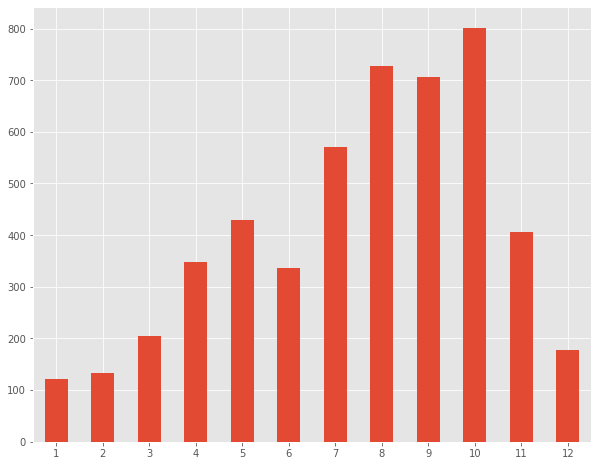

In [ ]:
# Get the number of strikes that occured during a specific month
strikes_by_month = wl_strikes['INCIDENT_MONTH'].value_counts()

# Sort the new Series by the index values, the month number
strikes_by_month = strikes_by_month.sort_index()

# Create a bar chart with the data, rotate the x-axis tick labels by 90 degrees
strikes_by_month.plot(kind='bar', rot=.5)


### Exercise 4: Compare wildlife strikes between flying animals and land animals

Compare wildlife strikes based on the catagorization of animals that can or cannot fly (Land animals and flying animals are identified in the column `SPECIES_TYPE`). Create a bar chart that visualizes the number in each category.

In [ ]:
#Show the counts for each category
wl_strikes['SPECIES_TYPE'].value_counts()

Flying animal    3972
Land animal       992
Name: SPECIES_TYPE, dtype: int64

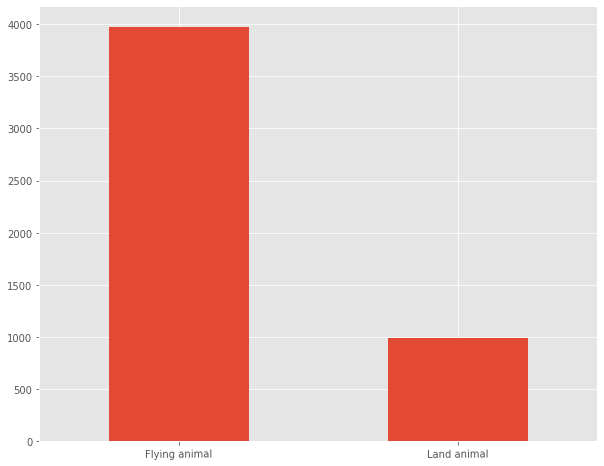

In [ ]:
# Create a bar chart to compare the counts of land animals vs flying animals
wl_strikes['SPECIES_TYPE'].value_counts().plot(kind='bar', rot=0.5)

### Exercise 5: Recreate the graphs in Seaborn and Altair
Recreate the graphs in exercises 3 and 4 with the Seaborn and Altair libraries.

Read more about these libraries in the documentation:
- [Seaborn documentation](https://seaborn.pydata.org/)
- [Seaborn `countplot()`](https://seaborn.pydata.org/generated/seaborn.countplot.html?highlight=countplot#seaborn.countplot)
- [Altair documentation](https://altair-viz.github.io/index.html)
- [Altair's "Simple Bar Chart" example](https://altair-viz.github.io/gallery/simple_bar_chart.html)

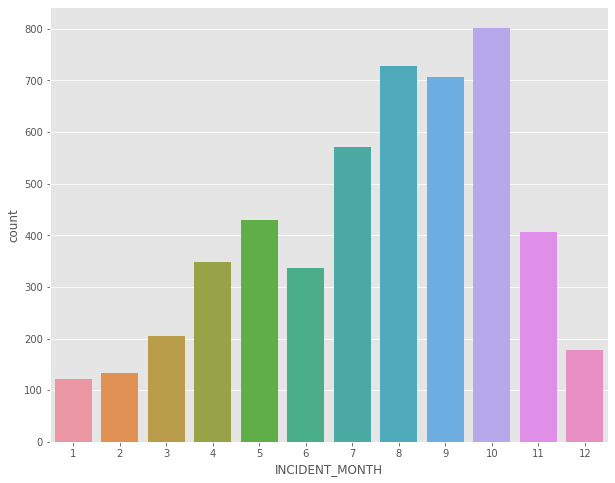

In [ ]:
# Exercise 3 in Seaborn using countplot()
sns.countplot(data=wl_strikes, x="INCIDENT_MONTH")

In [ ]:
# Exercise 3 in Altair using mark_bar()
alt.Chart(wl_strikes).mark_bar(size=20).encode(
    x='INCIDENT_MONTH',
    y='count(INCIDENT_MONTH)',
    tooltip = ['MONTH_NAME','count(INCIDENT_MONTH)']
).properties(width=500, height=400)

alt.Chart(...)

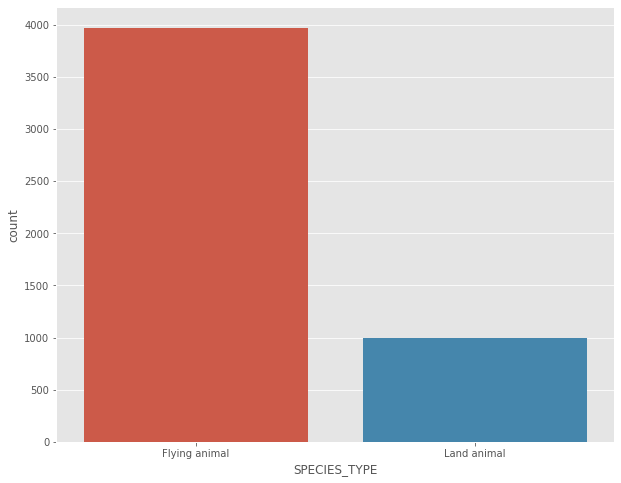

In [ ]:
# Exercise 4 in Seaborn using countplot()
sns.countplot(data=wl_strikes, x='SPECIES_TYPE')

In [ ]:
# Exercise 4 in Altair using mark_bar()
alt.Chart(wl_strikes).mark_bar(size=80).encode(
    x=alt.X('SPECIES_TYPE', axis=alt.Axis(labelAngle=0)),
    y='count(SPECIES_TYPE)',
    tooltip = ['SPECIES_TYPE','count(SPECIES_TYPE)']
).properties(width=300)

alt.Chart(...)

## Further resources

### Filled version of this notebook

[Python Open Labs Week 3 filled notebook](https://colab.research.google.com/github/NCSU-Libraries/data-viz-workshops/blob/master/Python_Open_Labs/Exploratory_analysis_and_visualization_with_Pandas/Python_Open_Labs_Week3_filled.ipynb) - a version of this notebook with all code filled in for the guided activity and exercises.

### Learning resources

- [Python Data Science Handbook](https://jakevdp.github.io/PythonDataScienceHandbook/index.html) - a free, online version of Jake VanderPlas' introduction to data science with Python, includes a chapter on data manipulation with pandas.

- [Python Programming for Data Science](https://www.tomasbeuzen.com/python-programming-for-data-science/README.html) - a website providing a great overview of conducting data science with Python including pandas.

- [Seaborn User guide and tutorial](https://seaborn.pydata.org/tutorial.html) - a guide and tutorial provided on the seaborn website

- [An Introduction to Altair](https://vallandingham.me/altair_intro.html) - a walkthrough introducing the basics of Altair

### Finding help with pandas

The [pandas website](https://pandas.pydata.org/) and [online documentation](http://pandas.pydata.org/pandas-docs/stable/) are useful resources, and of course the indispensible [Stack Overflow has a "pandas" tag](https://stackoverflow.com/questions/tagged/pandas).  There is also a (much younger, much smaller) [sister site dedicated to Data Science questions that has a "pandas" tag](https://datascience.stackexchange.com/questions/tagged/pandas) too.

## Evaluation Survey
Please, spend 1 minute answering these questions that help improve future workshops.

https://go.ncsu.edu/dvs-eval

## Credits

This workshop was created by Claire Cahoon and Walt Gurley, adapted from previous workshop materials by Scott Bailey and Simon Wiles, of Stanford Libraries.